In [1]:
import tweepy
import pandas as pd
import altair as alt
from datetime import datetime, timedelta,date
from collections import Counter
from operator import itemgetter
import tldextract
from wordcloud import WordCloud
from stop_words import get_stop_words
import matplotlib.pyplot as plt
import pickle
import random
import numpy as np

In [2]:
tweets = pickle.load(open("./tweets_migracion_general.pkl", "rb"))
keywords = ["Migrante", "Migraciones", "inmigrante","inmigrantes","inmigración",\
            "migrantes","migración","migracion","migraciones","inmigrante","población migrante","foráneos"]
tweets_flat = []
for l in tweets.values():
    tweets_flat.extend(l)

### Explorar tweets aleatoriamente

In [6]:
def random_tweets(list_of_tweets, n=5, visualize=True, bios=False):
    tweets = unify_text(list_of_tweets)
    chosen_tweets = random.choices(tweets, k = n)
    if visualize:
        if bios:
            for tweet in chosen_tweets:
                print('Nombre: ', tweet["user"]["name"])
                print('Bio: ', tweet["user"]["description"], end='\n*\n')
                print('Tweet: ', tweet["unified_text"], end='\n-------\n\n')
        else:
            for tweet in chosen_tweets:
                print(tweet["user"]["name"])
                print(tweet["unified_text"], end='\n-------\n\n')
    else:
        return chosen_tweets

In [14]:
random_tweets(tweets["migración"], bios=True)

Nombre:  Yasmina García Hdez
Bio:  Vicesecretaria Insular de CCLaGomera. Y lo más importante, MamaOrgullosa
*
Tweet:  Un nuevo ejemplo del abandono del Estado a #Canarias. Hoy nos hemos enterado que el PSOE ha decidido aparcar la Ponencia de Migración del @Senadoesp ideada para analizar y dar respuesta a la crisis migratoria. Una vez más cierran en falso la crisis por puro oportunismo político https://t.co/efFpsIrhOB
-------

Nombre:  Cedoz
Bio:  Centro de Documentación sobre Zapatismo
*
Tweet:  El segundo grupo de la delegación perdió su vuelo por que migración los demoró demasiado. Con más razón aquí en Viena continuamos la manifestación ceelbratoria por la visita.
#EZLN #lagirazapatistava #LaExtemporánea https://t.co/gDMkrOi0sf
-------

Nombre:  Lydia Merchan
Bio:  
*
Tweet:  @JOAQUINRUIZD Hablamos  aquí
De un pollo en evolución
Llegará  volando así
En tremenda migración 

Los pollos no volaban 
Según se decía
A menos que lo cazaran
Entre la DEA y la CIA

El pollo más caro 
Que se h

### Los más X

In [9]:
functions = [most_used_hashtags, most_mentioned_users, most_retweeted_urls]
# Cambiar a Pandas desde el principio
most_popular = np.empty((10*len(keywords), 2*len(functions)), dtype='U300')
for i in range(len(keywords)):
    for j in range(len(functions)):
        # Sería mejor si todas las funciones tuviesen como output un Counter
        col = np.array(Counter(functions[j](tweets[keywords[i]], 10)).most_common(10))
        most_popular[10*i:10*(i+1), 2*j:2*(j+1)] = col

[('aestahora', 47), ('afianzando', 30), ('aeronavales', 30), ('migrante', 17), ('méxico', 15), ('migrantes', 13), ('equipominmujeryeg', 12), ('chiapas', 11), ('sepaque', 11), ('xenofobia', 10)]
[('noeliajmz', 68), ('anadebla', 45), ('SENANPanama', 29), ('ConcejalMandyG', 22), ('SamuraiGT502', 20), ('ConcejoDeBogota', 19), ('MadeCaracas', 16), ('XiniaNavarro', 15), ('AlejandroGL2014', 15), ('BienestarSociaI', 13)]
{'https://www.huffingtonpost.es/entry/detenido-un-empresario-en-melilla-por-explotar-a-un-menor-migrante-que-perdio-un-dedo_es_613cc922e4b0dda4cbcf3aaf?ttp': 950, 'https://www.huffingtonpost.es/entry/detenido-un-empresario-en-melilla-por-explotar-a-un-menor-migrante-que-perdio-un-dedo_es_613cc922e4b0dda4cbcf3aaf?utm_campaign=share_twitter&ncid=engmodushpmg00000004': 346, 'https://twitter.com/potus/status/1437539604492607492': 174, 'https://twitter.com/ElHuffPost/status/1436716276097880071': 166, 'https://mty.telediario.mx/nacional/amlo-ordena-la-sre-iniciar-campana-para-impuls

{'https://twitter.com/MGTrevijano/status/1437149718472179716': 3246, 'https://elpais.com/espana/madrid/2021-09-03/asi-se-fabrica-una-mentira-el-bulo-de-la-cuidadora-okupa-inventado-para-acosar-a-una-inquilina-inmigrante.html': 1442, 'https://gaceta.es/actualidad/un-hombre-sufre-una-agresion-homofoba-de-un-inmigrante-marroqui-en-melilla-mereces-la-muerte-pecador-esta-ciudad-es-para-musulmanes-20210913-1720/': 462, 'https://twitter.com/rubnpulido/status/1437704665450393600': 136, 'https://www.paypal.me/kadso': 68, 'https://twitter.com/gaceta_es/status/1437763070814732289': 38, 'https://www.descifrandolaguerra.es/emiratos-arabes-unidos-un-infierno-de-lujo-para-la-inmigracion/': 32, 'https://okdiario.com/andalucia/inmigrante-nigeriano-apunala-tres-veces-vecina-que-tuvo-problemas-7776236': 16, 'https://twitter.com/ArMoNyA_48/status/1437668627256381440': 16, 'https://twitter.com/CacaitoPuro/status/1437743199582314498': 14}
[('aestahora', 57), ('afianzando', 30), ('aeronavales', 30), ('camina

In [11]:
# No pude meter most_retweeted_domains no sé por qué
functions = [most_used_hashtags, most_mentioned_users, most_retweeted_urls]
most_popular = {f.__name__:{} for f in functions}
for f in functions:
    for keyword in keywords:
        # Sería mejor si todas las funciones tuviesen como output un Counter
        most_popular[f.__name__][keyword] = Counter(f(tweets[keyword], 10)).most_common(10)

# most_retweeted_tweets(tweets["migración"], 10)
# Me cuenta los retweets varias veces, por lo que solo me aparece el tweet más popular

,id,created_at,unified_text,rts_global_count,user
0,1438111969807061000,Wed Sep 15 12:06:27 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,XZheroa
1,1438111423620583425,Wed Sep 15 12:04:16 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,Navygator2020
2,1438110119758385152,Wed Sep 15 11:59:06 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,dianaalbornoz8
3,1438109906192715777,Wed Sep 15 11:58:15 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,ElPitazoTV
4,1438109825716690948,Wed Sep 15 11:57:55 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,lajovencuba
5,1438109636784238598,Wed Sep 15 11:57:10 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,caferoco16
6,1438109630467555333,Wed Sep 15 11:57:09 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,AlicerMartinez
7,1438108521665597447,Wed Sep 15 11:52:44 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,arepadulce
8,1438107058746937356,Wed Sep 15 11:46:56 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,elrealista56
9,1438106695704719369,Wed Sep 15 11:45:29 +0000 2021,"#NOTICIA Migración Colombia acaba de anunciar el inicio de un proceso administrativo sancionatorio a la ex senadora Piedad Córdoba Ruíz, por no registrar su ingreso al país desde Venezuela el día de ayer en la frontera.",1462,DenunciaJulio


In [10]:
mi = pd.MultiIndex.from_product([keywords, list(range(1,11))])
df = pd.DataFrame(most_popular)
df

,0,1,2,3,4,5
0,aestahora,47,noeliajmz,68,https://www.huffingtonpost.es/entry/detenido-u...,950
1,afianzando,30,anadebla,45,https://www.huffingtonpost.es/entry/detenido-u...,346
2,aeronavales,30,SENANPanama,29,https://twitter.com/potus/status/1437539604492...,174
3,migrante,17,ConcejalMandyG,22,https://twitter.com/ElHuffPost/status/14367162...,166
4,méxico,15,SamuraiGT502,20,https://mty.telediario.mx/nacional/amlo-ordena...,128
...,...,...,...,...,...,...
115,batalladechile,4,IMVillarroel1,25,https://www.medicoslaspalmas.es/index.php/noti...,4
116,saltillo,3,xavuno,24,https://chat.whatsapp.com/BPwlBdrNmvW2R4Blo8IsXe,4
117,citybus,3,jcy126kerubin,18,https://buff.ly/3kElHoM,4
118,b4rbi3girl,3,ClaMoralesM,13,https://twitter.com/racd23_/status/14375777979...,4


### Nubes de palabras

Migrante


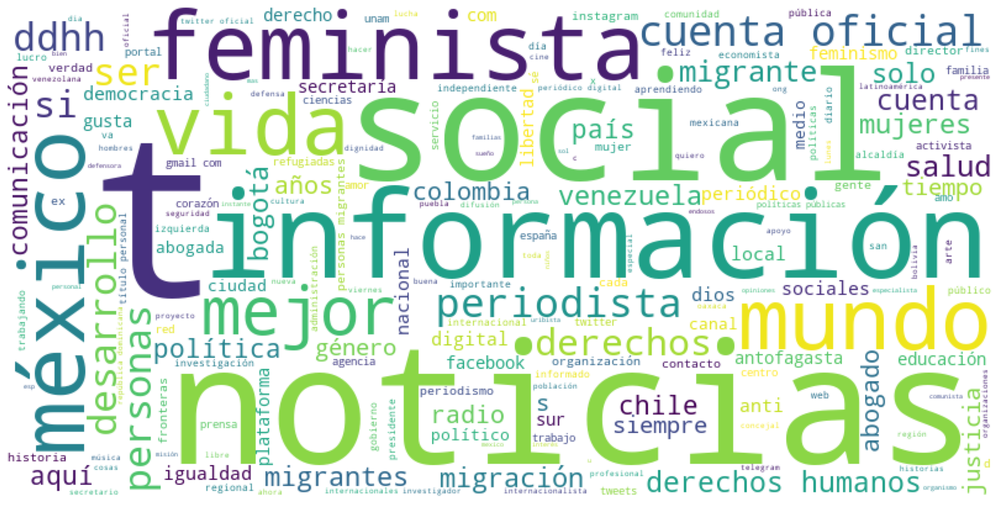

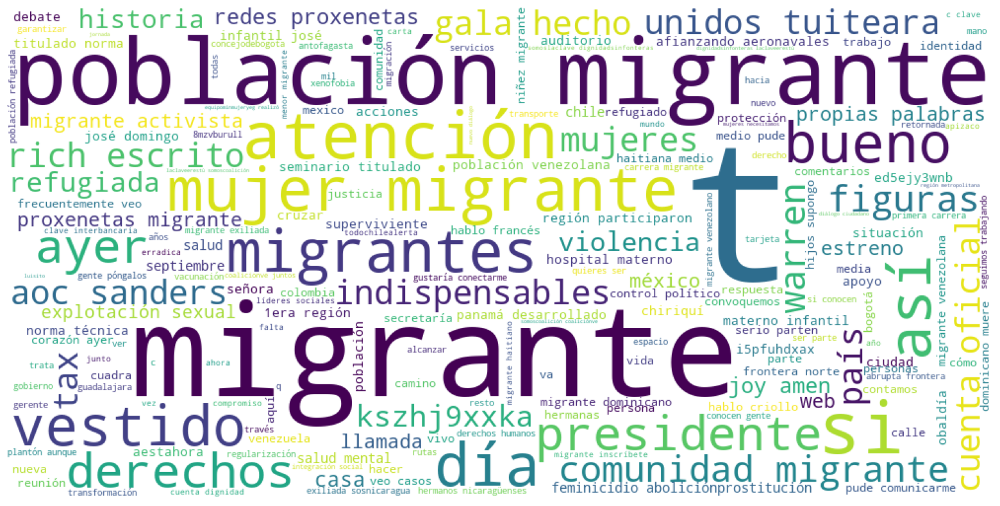

Migraciones


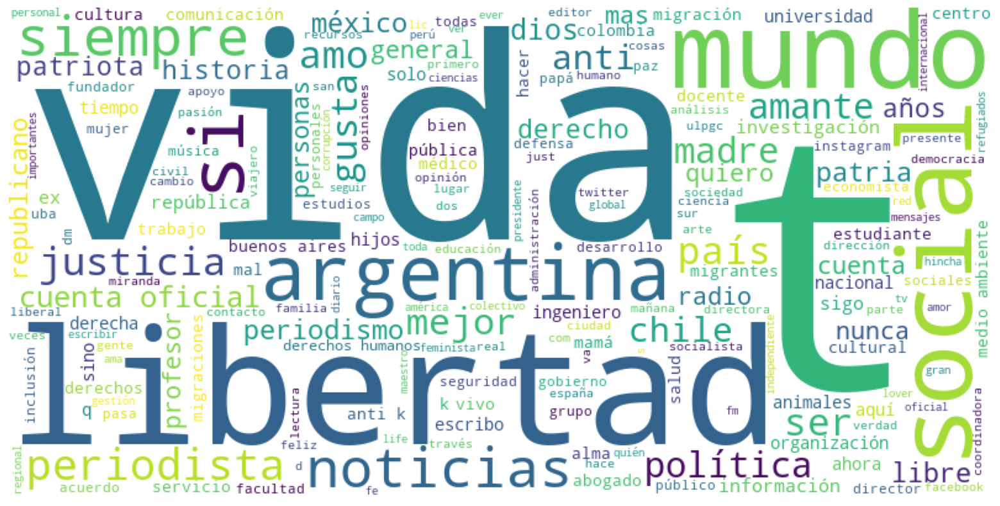

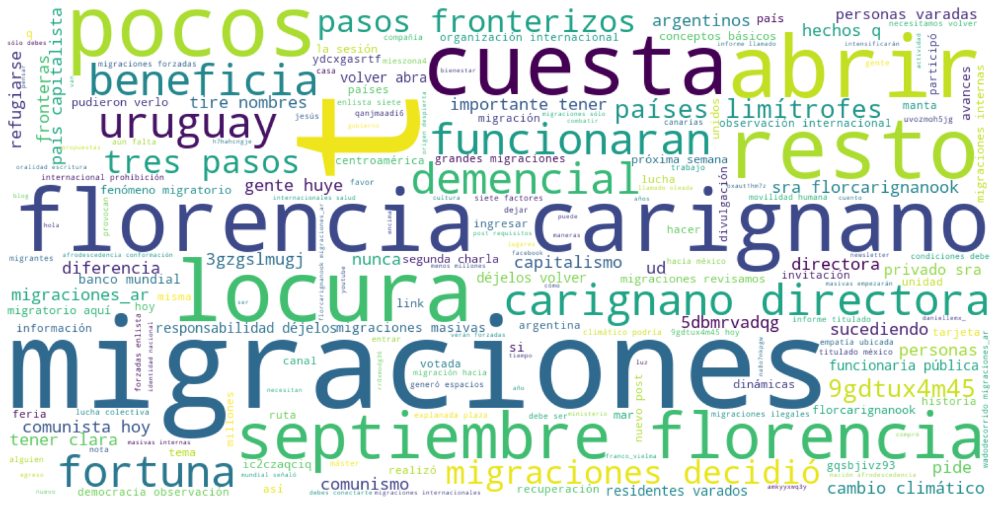

inmigrante


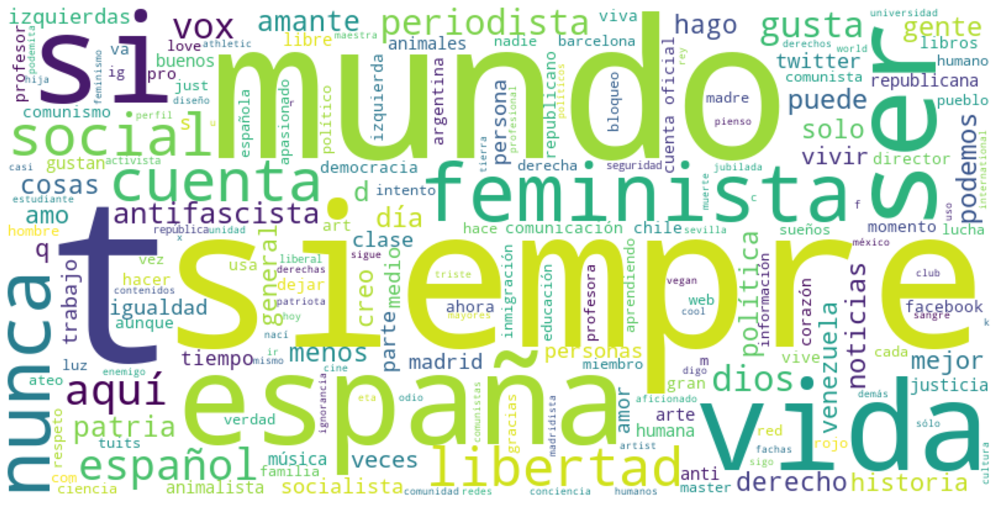

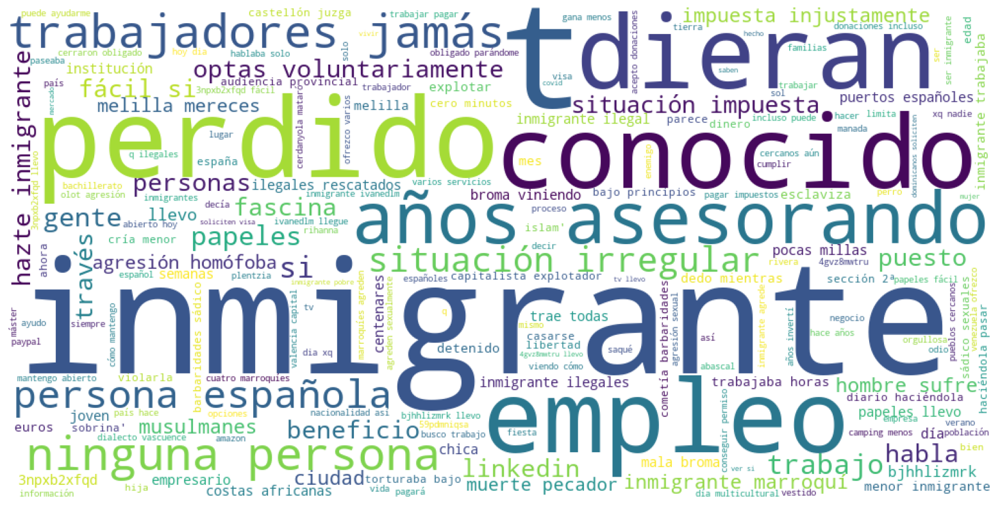

inmigrantes


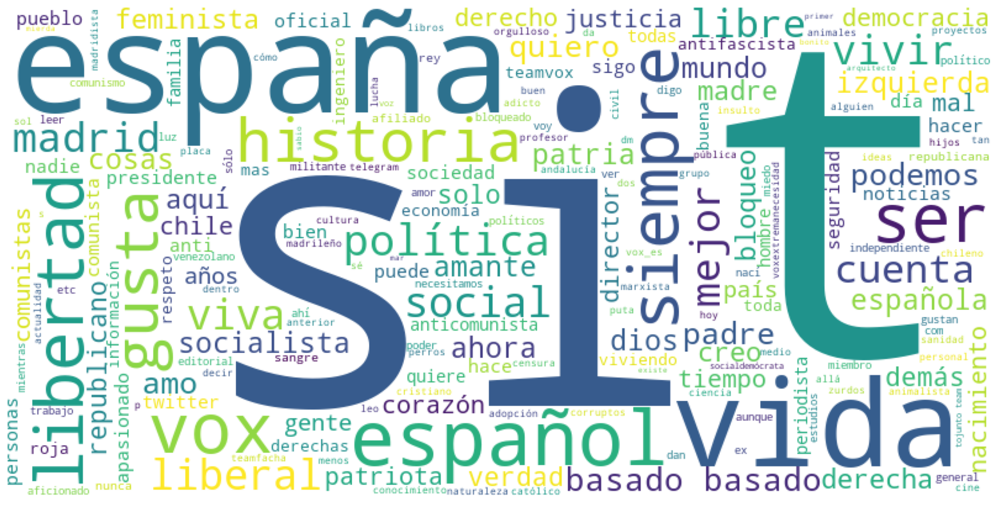

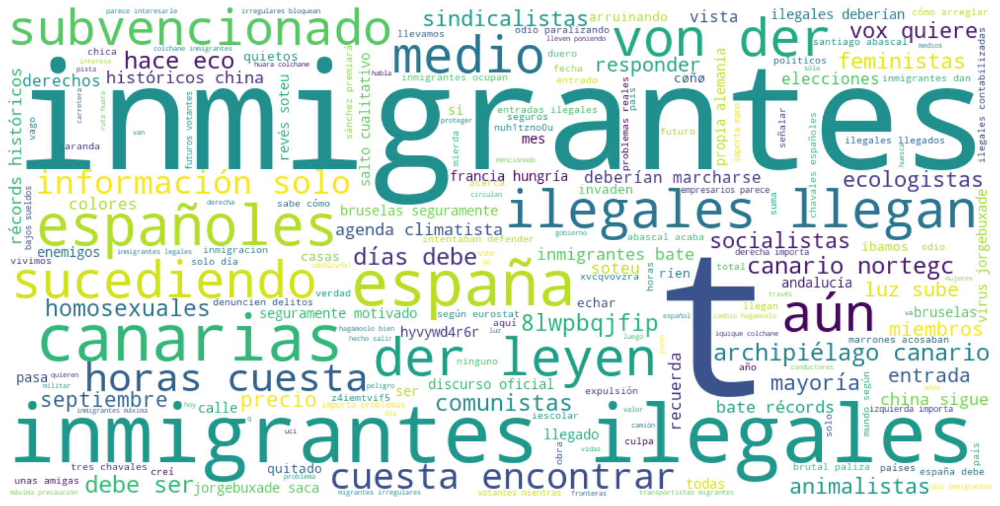

inmigración


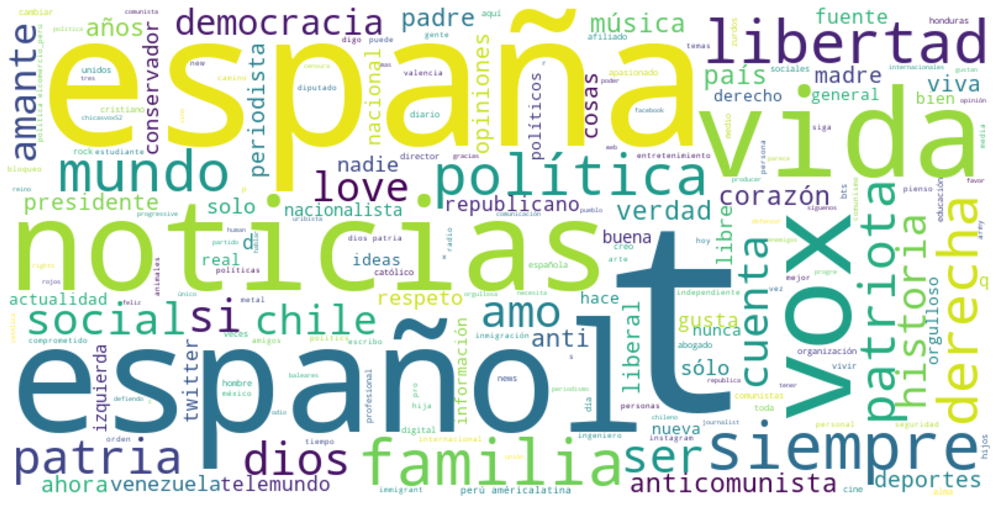

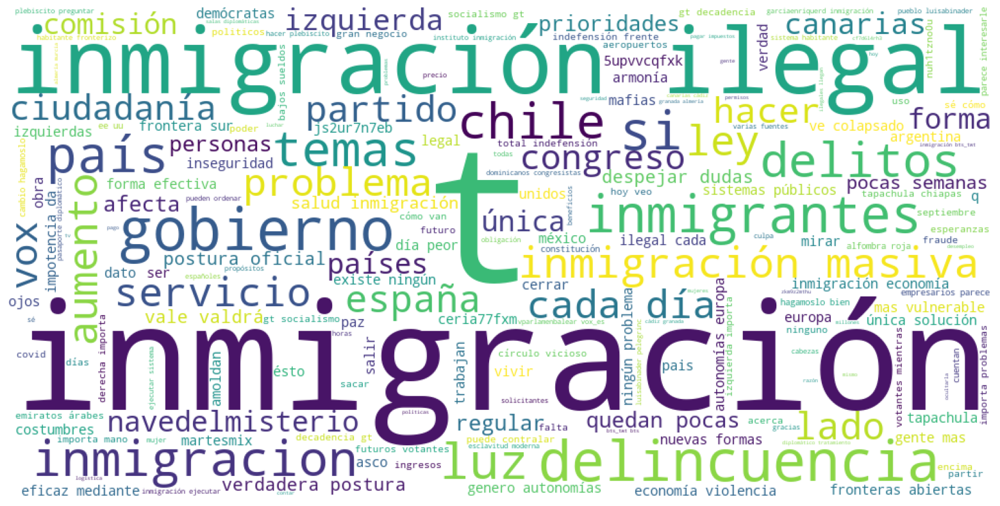

migrantes


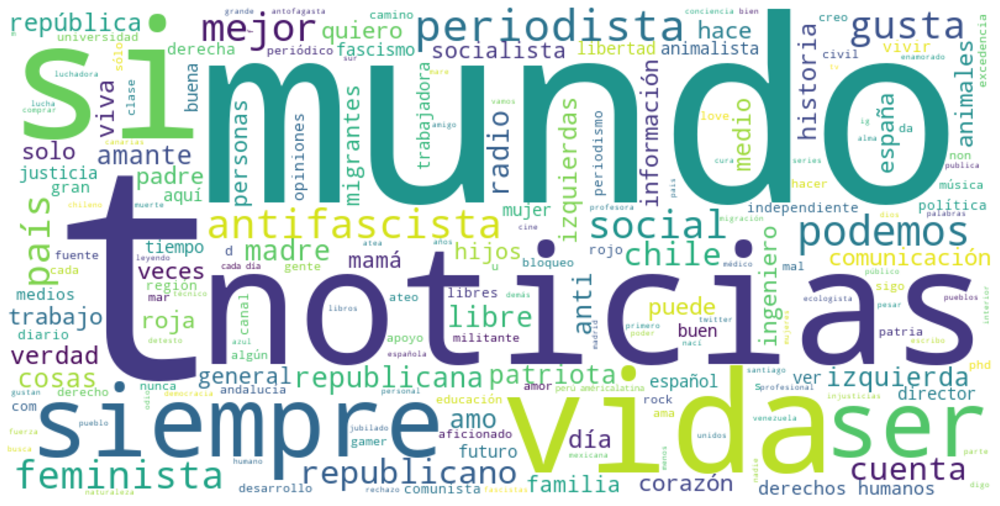

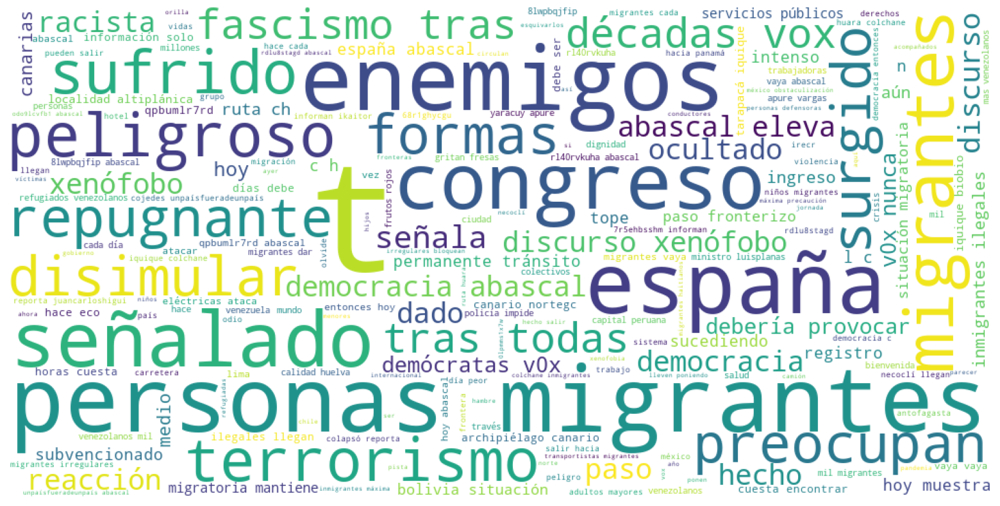

migración


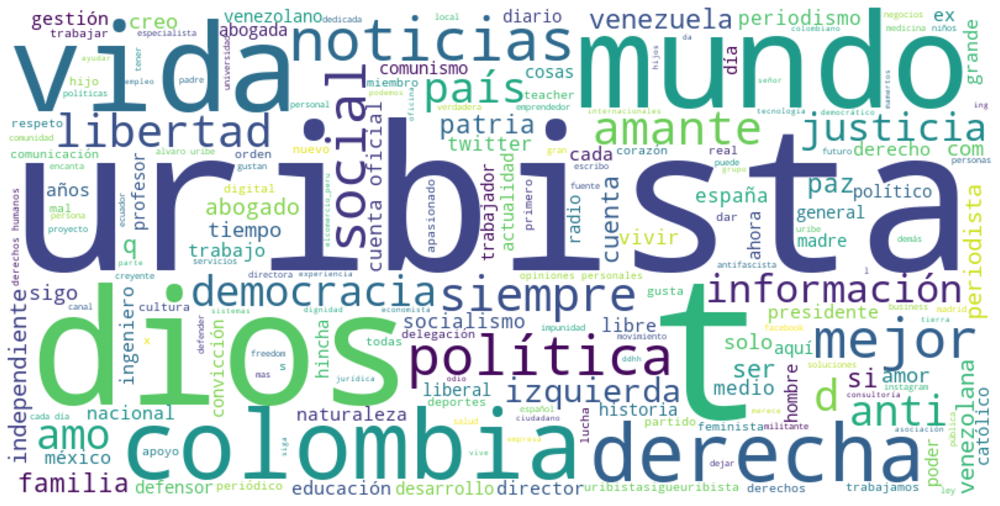

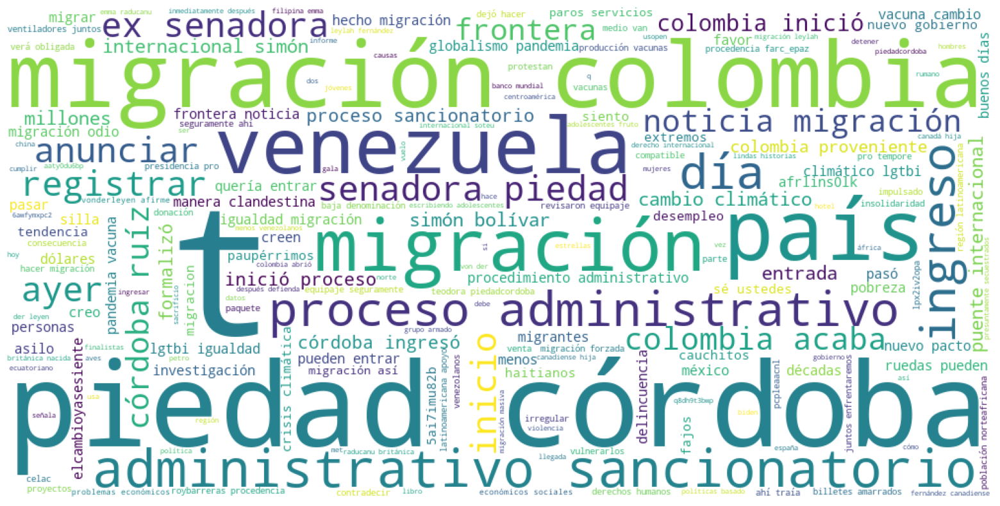

migracion


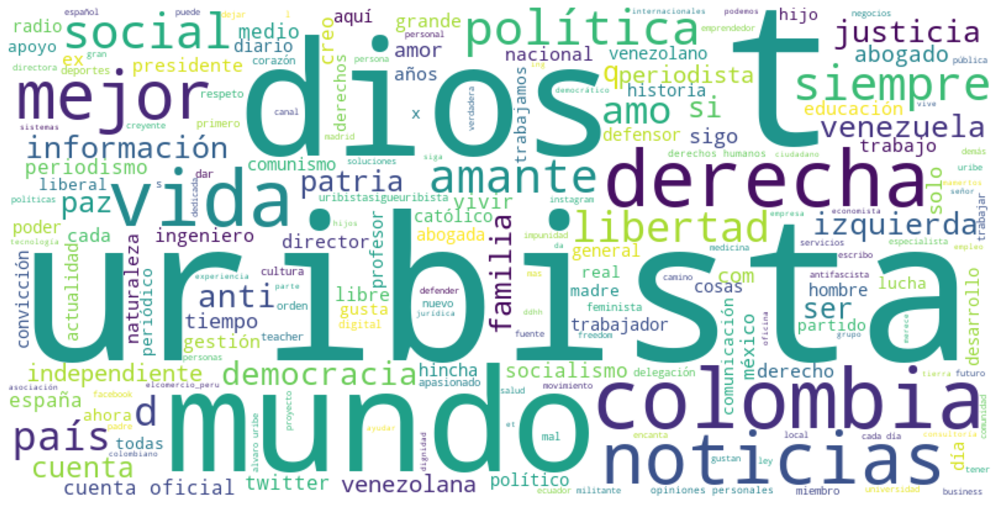

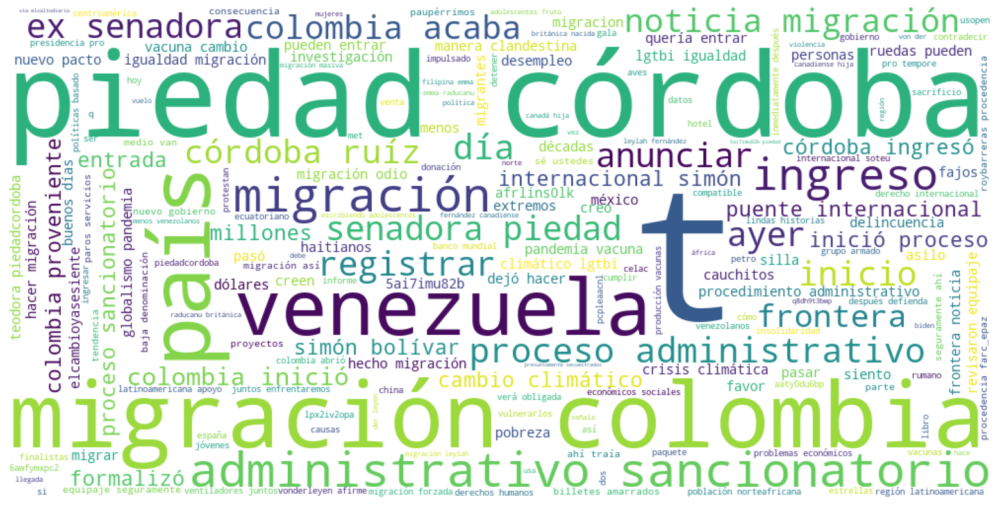

migraciones


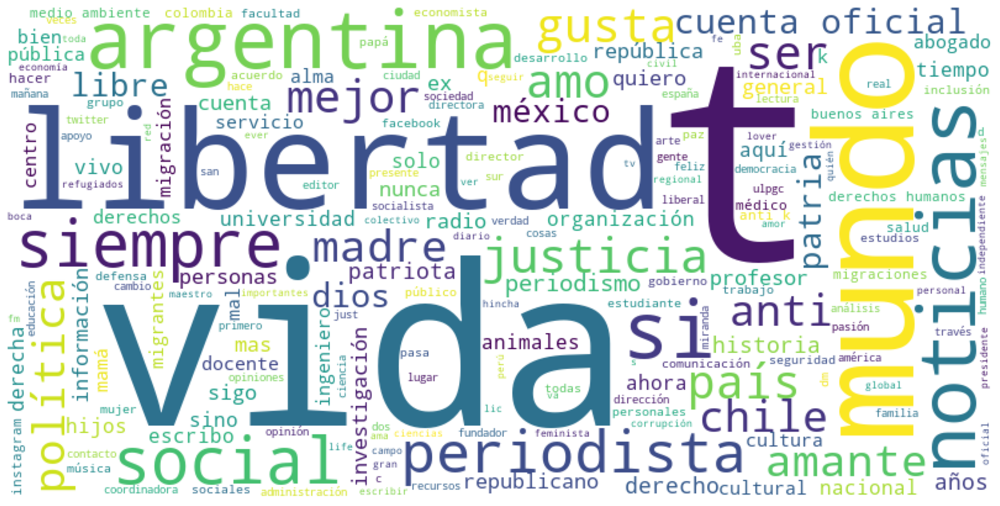

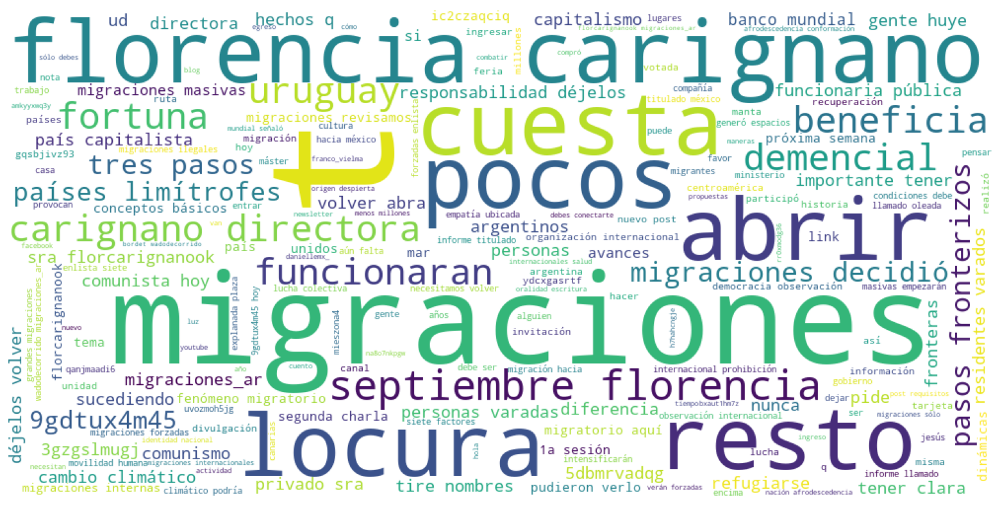

población migrante


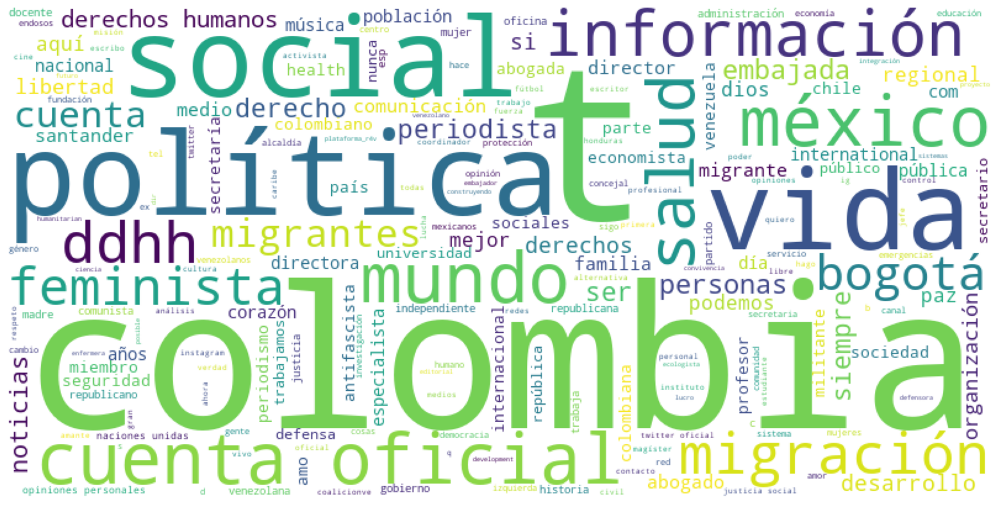

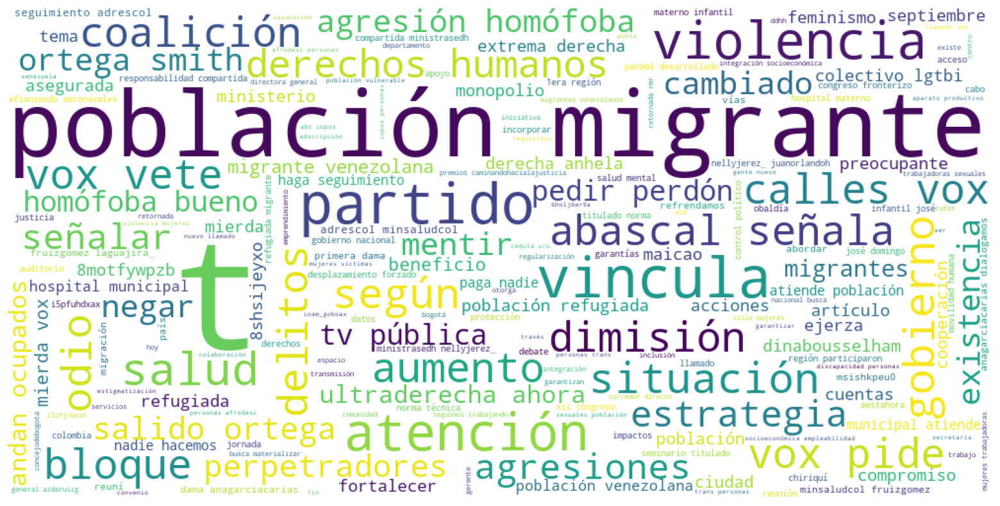

foráneos


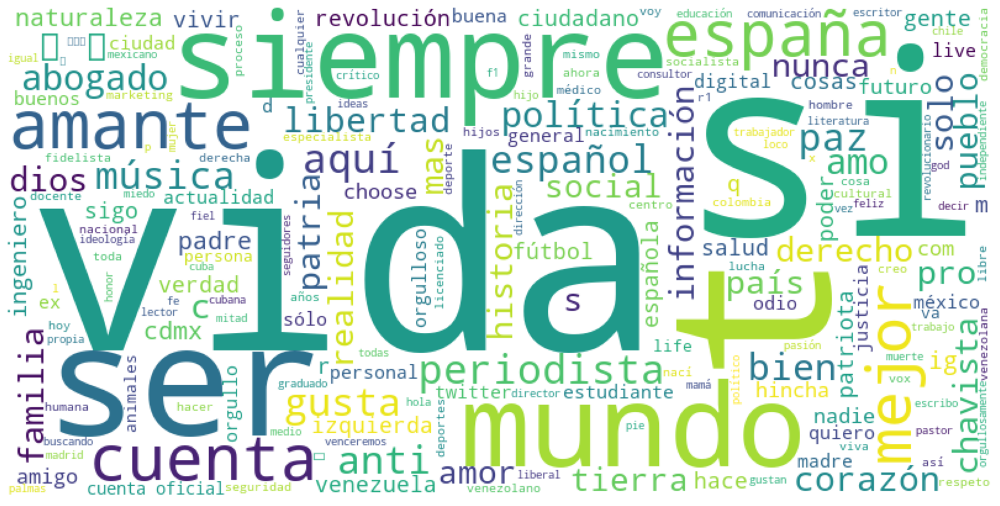

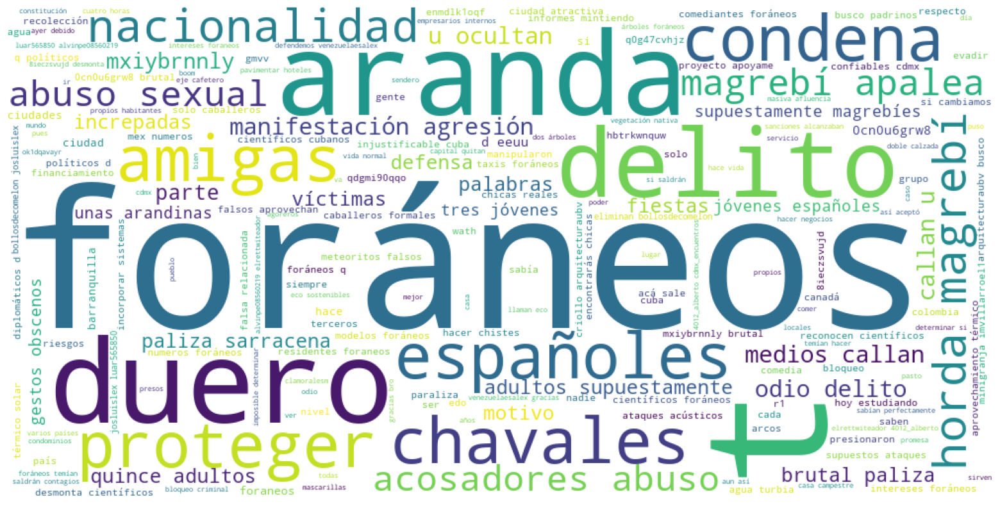

In [8]:
for keyword, tw in tweets.items():
    print(keyword)
    wordcloud_bios(tw, f'/Nubes/nube_bio_{keyword}')
    wordcloud_tweets(tw, f'/Nubes/nube_tweets_{keyword}')


### Paquete común twitter-explorer

In [5]:
def timeline (list_of_tweets, identifier):
    """Returns a chart with the count of tweets per day and save it with the identifier
    
    Arguments
    _ _ _ _ _ _ _
    
    list_of_tweets: dict
        use dictionary that are return from Twitter api 
    identifier: str 
        name to save the chart"""    
    creation_dates=[tweet["created_at"] for tweet in list_of_tweets]
    df = pd.DataFrame({'dates':creation_dates})
    df.dates = df.dates.astype("datetime64")+ timedelta(hours=-5)
    df['just_date'] = df['dates'].dt.date

    counts= df.groupby(["just_date"]).size()
    counts=counts.to_frame(name = 'count').reset_index()
    counts.just_date=pd.to_datetime(counts.just_date)
    counts.sort_values(by=['just_date'])
    counts['just_date'] = pd.to_datetime(counts['just_date'])

    chart=alt.Chart(counts).mark_line(point=True).encode(
        x='just_date',
        y='count'
    ).properties(
        title='Número de tuits en el tiempo'
    )
    chart.save("timeline_"+identifier+"_"+str(date.today())+".html")
    return (chart)





def most_used_hashtags(list_of_tweets,n):
    """Returns a list of the most used hashtags
    
    Arguments
    _ _ _ _ _ _ _
    
    list_of_tweets: dict
        use dictionary that is returned from Twitter api 
    n: int 
        lenght of the list that will be returned"""    
    #Most used hashtags:
    hashtags=[]
    w_o_ht=[]
    for tweet in list_of_tweets:
        ht=[tweet["entities"]["hashtags"][i]["text"].lower()for i in range(0,len(tweet["entities"]["hashtags"]))]
        if len(ht)==0:
            w_o_ht.append(tweet) 
        else:
            hashtags=hashtags+ht

    c = Counter(hashtags)
    print(c.most_common(n))

    return(c)





def most_mentioned_users(list_of_tweets,n):
    """Returns a list of the most mentioned users
    
    Arguments
    _ _ _ _ _ _ _
    
    list_of_tweets: dict
        use dictionary that is returned from Twitter api 
    n: int 
        lenght of the list that will be returned"""    
    
    #Most mentioned users:
    mentions=[]
    w_o_mt=[]
    for tweet in list_of_tweets:
        mt=[tweet["entities"]["user_mentions"][i]["screen_name"]for i in range(0,len(tweet["entities"]["user_mentions"]))]
    
        if len(mt)==0:
            w_o_mt.append(tweet) 
        else:
            mentions=mentions+mt

    c = Counter(mentions)
    print(c.most_common(n))

    return(c)





def most_used_urls(list_of_tweets,n):
    
    """Returns a list of the most used urls
    
    Arguments
    _ _ _ _ _ _ _
    
    list_of_tweets: dict
        use dictionary that is returned from Twitter api 
    n: int 
        lenght of the list that will be returned"""    

    urls=[]
    sin_url=[]
    n_rts=[]
    for tweet in list_of_tweets:
        if "retweeted_status"in tweet.keys():
            url=[tweet["retweeted_status"]["entities"]["urls"][i]["expanded_url"]for i in range(0,len(tweet["retweeted_status"]["entities"]["urls"]))]
        elif "quoted_status"in tweet.keys():
            url=[tweet["quoted_status"]["entities"]["urls"][i]["expanded_url"]for i in range(0,len(tweet["quoted_status"]["entities"]["urls"]))]
            url=url.extend([tweet["entities"]["urls"][i]["expanded_url"]for i in range(0,len(tweet["entities"]["urls"]))])
        else:
            url=[tweet["entities"]["urls"][i]["expanded_url"]for i in range(0,len(tweet["entities"]["urls"]))]
        if url is not None:

            urls=urls+url

    c = Counter(urls)
    print(c.most_common(n))

    return(c)




def most_used_domains(list_of_tweets,n):

	"""Returns a list of the most used domains
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api 
	n: int 
		lenght of the list that will be returned"""
	urls=most_used_urls(list_of_tweets,0)
	dominios={}
	for url in urls.keys():
		ext = tldextract.extract(url)
		if ext.domain in dominios.keys():
			dominios[ext.domain]+=urls[url]
		else:
			dominios[ext.domain]=urls[url]
	dominios_sorted=dict(sorted(dominios.items(), key = itemgetter(1), reverse = True)[:n])
			
	print(dominios_sorted)
	return(dominios)



def most_retweeted_urls(list_of_tweets,n):
	"""Returns a list of the most retweeted urls
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api 
	n: int 
		lenght of the list that will be returned"""


    
	urls={}
	sin_url=[]
	n_rts=[]
	for tweet in list_of_tweets:
		url=[tweet["entities"]["urls"][i]["expanded_url"]for i in range(0,len(tweet["entities"]["urls"]))]
		
		if len(url)==0:
			sin_url.append(tweet) 
		else:
			for u in url:
				if u in urls.keys():
					urls[u]=max(tweet['retweet_count'],urls[u])
				else:
					urls[u]=tweet['retweet_count']
		try:
			url=[tweet["retweeted_status"]["entities"]["urls"][i]["expanded_url"]for i in range(0,len(tweet["retweeted_status"]["entities"]["urls"]))]
			
			for u in url:
				if u in urls.keys():
					urls[u]=max(tweet['retweet_count']+tweet["retweeted_status"]['retweet_count'],urls[u])
				else:
					urls[u]=tweet['retweet_count']+tweet["retweeted_status"]['retweet_count']
			url=[tweet["quoted_status"]["entities"]["urls"][i]["expanded_url"]for i in range(0,len(tweet["quoted_status"]["entities"]["urls"]))]
			for u in url:
				if u in urls.keys():
					urls[u]=max(tweet['retweet_count']+tweet["quoted_status"]['retweet_count'],urls[u])
				else:
					urls[u]=tweet['retweet_count']+tweet["quoted_status"]['retweet_count']
					
		except:
			next
	urls_sorted=dict(sorted(urls.items(), key = itemgetter(1), reverse = True)[:n])
	print(urls_sorted)
	return(urls)




def most_retweeted_domains(urls,n):
    
	"""Returns a list of the most retweeted domains
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api 
	n: int 
		lenght of the list that will be returned"""
    
	dominios={}
	for url in urls.keys():
		ext = tldextract.extract(url)
		if ext.domain in dominios.keys():
			dominios[ext.domain]+=urls[url]
		else:
			dominios[ext.domain]=urls[url]
	dominios_sorted=dict(sorted(dominios.items(), key = itemgetter(1), reverse = True)[:n])
			
	print(dominios_sorted)
	return(dominios)





def unify_text(list_of_tweets):
	"""Unifies text into a single text category   
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api"""
	for tweet in list_of_tweets:
		if "extended_tweet" in tweet.keys():
			tweet["unified_text"]=tweet["extended_tweet"]["full_text"]
		if "full_text" in tweet.keys():
			tweet["unified_text"]=tweet["full_text"]
		if "retweeted_status" in tweet.keys() and "extended_tweet" in tweet["retweeted_status"].keys():
			tweet["unified_text"]=tweet["retweeted_status"]["extended_tweet"]["full_text"]
		if "retweeted_status" in tweet.keys()and "full_text" in tweet["retweeted_status"].keys():
			tweet["unified_text"]=tweet["retweeted_status"]["full_text"]
		
		if "quoted_status" in tweet.keys() and "extended_tweet" in tweet["quoted_status"].keys():
			tweet["unified_text"]=tweet["full_text"]+tweet["quoted_status"]["extended_tweet"]["full_text"]
		
		if "quoted_status" in tweet.keys()and "full_text" in tweet["quoted_status"].keys():
			tweet["unified_text"]=tweet["full_text"]+tweet["quoted_status"]["full_text"]
		
		if  "quoted_status" in tweet.keys():
			tweet["unified_text"]=tweet["full_text"]+tweet["quoted_status"]["full_text"]
		
		if "unified_text" not in tweet.keys():
			tweet["unified_text"]=tweet["full_text"]
	
	return(list_of_tweets)




def sum_of_rts(list_of_tweets):
	"""Adds up all the retweets for text containing the same corpus   
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api"""    
	for tweet in list_of_tweets:
		tweet["rts_global_count"]=tweet["retweet_count"]
		if "quoted_status" in tweet.keys():
			tweet["rts_global_count"]+=tweet["quoted_status"]['retweet_count']
		if "retweeted_status" in tweet.keys():
			tweet["rts_global_count"]+=tweet["retweeted_status"]['retweet_count']
	return(list_of_tweets)


# In[ ]:


def most_retweeted_tweets(list_of_tweets,n):
	"""Returns the top n tweets with most retweets   
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api
	n: int 
		lenght of the list that will be returned"""       
	tweets_procesados=unify_text(list_of_tweets)
	tweets_procesados=sum_of_rts(tweets_procesados)
	sorted_byRts=sorted(tweets_procesados, key = lambda i: i["rts_global_count"],reverse=True)
	#Most retwited twits:
	
	pd.set_option("max_colwidth",300)
	df = pd.DataFrame.from_dict(sorted_byRts)
	df['user'] = [list_of_tweets[i]["user"]["screen_name"] for i in range(0,len(list_of_tweets))]
	df=df[["id",'created_at','unified_text',"rts_global_count","user"]]
	return(df.head(n))




def find_tweets_by_id(list_of_tweets, id):
	"""Search tweet based on id number   
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api
	id: int 
		Status ID, unique tweet identificator"""      
	trinos=[]
	for tweet in list_of_tweets:
		if tweet["id"]==id:
			trinos.append(tweet)
			print(tweet["text"])
	return(trinos)





def wordcloud_bios(list_of_tweets, name):
	"""Returns wordcloud with most frequent character strings in user's bios. Repeated bios are disregarded.    
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api
	name:  
		Name where you wish to save the plot"""  
	bios=[tweet["user"]["description"] for tweet in list_of_tweets]
	bios=list(filter(None, bios))
	unique_bios=list(set(bios))
	bios_str=' '.join(unique_bios)
	bios_str=bios_str.lower()
	stopwords_es= get_stop_words('es')
	stopwords_es.append("rt")
	stopwords_es.extend(["https","co"])
	stopwords_es.extend( get_stop_words('en'))
	wordcloud = WordCloud(background_color ='white',stopwords=stopwords_es,width=800, height=400,collocations=True, normalize_plurals=False).generate(bios_str) 
	  
	# plot the WordCloud image                        
	plt.figure( figsize=(20,10) )
	plt.imshow(wordcloud) 
	plt.axis("off") 
	plt.savefig("./"+name+"png")
	plt.show() 




def wordcloud_tweets(list_of_tweets, name):
	"""Returns wordcloud with most frequent character strings in the tweets' corpus.  
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api
	name:  
		Name where you wish to save the plot"""     
	tweets_procesados=unify_text(list_of_tweets)
	text=[tweet["unified_text"] for tweet in tweets_procesados]
	texto_str=' '.join(text)
	texto_str=texto_str.lower()
	stopwords_es= get_stop_words('es')
	stopwords_es.append("rt")
	stopwords_es.extend(["https","co"])
	stopwords_es.extend( get_stop_words('en'))
	wordcloud = WordCloud(background_color ='white',stopwords=stopwords_es,width=1000, height=500,collocations=True, normalize_plurals=False).generate(texto_str)
	# plot the WordCloud image                        
	plt.figure( figsize=(20,10) )
	plt.imshow(wordcloud) 
	plt.axis("off") 
	plt.savefig("./"+name+"png")
	plt.show() 



def find_tweets_by_text (list_of_tweets, list_of_terms):
	"""return filter tweets based on a list of terms  
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api
	list_of_terms: list
		List of character strings to filter out"""   
	list_of_tweets=unify_text(list_of_tweets)
	filtered_tweets=[ x for x in list_of_tweets if any(word in x["unified_text"].lower() for word in list_of_terms)]
	return(filtered_tweets)


def wordcloud_filtered_tweets(list_of_tweets, list_of_terms,name):
	"""return a wordcloud with the most frequent character stings based on a filtered list of terms  
    
	Arguments
	_ _ _ _ _ _ _
	list_of_tweets: dict
		use dictionary that is returned from Twitter api
	list_of_terms: list
		List of character strings to filter out
	name:  
		Name where you wish to save the plot"""
	filtered_tweets=find_tweets_by_text (list_of_tweets, list_of_terms)
	wordcloud=wordcloud_tweets(filtered_tweets, name)


### Extracción inicial de datos

In [8]:
####input your credentials here
APP_KEY3 = 'aFwUy2WO8YPbk2H3b4mmSZDSE'
APP_SECRET3 = 'hdqxuR4ApeKKLPicHSr4XRkxekGexqrTjpv0v2usEQ4K1lxEmL'
OAUTH_TOKEN3 = '1434944736201216008-YLp0Ww1lHcj0NxNCjxJ0NXkxBtGWYP'
OAUTH_TOKEN_SECRET3 ='KYlBPCi6WPYkuWISKv5reSofyAsotV5Oay91NE6cjlSzP'

auth = tweepy.OAuthHandler(APP_KEY3, APP_SECRET3)
auth.set_access_token(OAUTH_TOKEN3, OAUTH_TOKEN_SECRET3)

api3 = tweepy.API(auth,wait_on_rate_limit=True,wait_on_rate_limit_notify=True)

In [19]:
# Extraer 1000 tweets por cada keyword
keywords = ["Migrante", "Migraciones", "inmigrante","inmigrantes","inmigración",\
            "migrantes","migración","migracion","migraciones","inmigrante","población migrante","foráneo"]

tweets={keywords[i]:[] for i in range(len(keywords))}

for word in keywords:
    for tweet in tweepy.Cursor(api3.search,q=word,count=100,
                    lang="es",tweet_mode='extended',since="2021-09-05").items(1000):

        tweets[word].append(tweet._json)

In [22]:
with open("./tweets_migracion_general.pkl","wb") as f:
    pickle.dump(tweets, f)